# Advanced RNA Trajectory Analysis Plots

This notebook demonstrates advanced analysis plots for RNA trajectories:
1. End-to-End Distance
2. Radius of Gyration
3. DSSR Secondary Structure Analysis
4. PCA/UMAP/t-SNE Conformational Analysis

All plots are created using Plotly for interactive visualization.

In [1]:
!pip install umap-learn

In [2]:
import numpy as np
import pandas as pd
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.offline as pyo

# MD Analysis
import MDAnalysis as mda
from MDAnalysis.analysis import rms
from MDAnalysis.analysis.base import AnalysisBase

# Dimensionality reduction
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import umap

# Barnaba for RNA analysis
import barnaba as bb

# System
import os
import sys
sys.path.append('../../')

# Set up paths
topology_file = '../../data/examples/frame_0_noions.pdb'
trajectory_file = '../../data/examples/SHAW_8500_10418.xtc'

print(f"Topology: {topology_file}")
print(f"Trajectory: {trajectory_file}")
print(f"Files exist: {os.path.exists(topology_file)} / {os.path.exists(trajectory_file)}")

Topology: ../../data/examples/frame_0_noions.pdb
Trajectory: ../../data/examples/SHAW_8500_10418.xtc
Files exist: True / True


## Load Trajectory and Basic Setup

In [3]:
# Load trajectory with MDAnalysis
u = mda.Universe(topology_file, trajectory_file)

print(f"Number of frames: {len(u.trajectory)}")
print(f"Number of atoms: {len(u.atoms)}")
print(f"Number of residues: {len(u.residues)}")
print(f"Residue names: {[res.resname for res in u.residues]}")

# RNA selection
rna = u.select_atoms("nucleic")
rna_backbone = u.select_atoms("nucleic and backbone")
print(f"RNA atoms: {len(rna)}")
print(f"RNA backbone atoms: {len(rna_backbone)}")

# Get frame times (assuming 1 ns intervals)
frames = np.arange(len(u.trajectory))
times_ns = frames * 0.1  # Adjust based on your trajectory timestep

print(f"Time range: {times_ns[0]:.1f} - {times_ns[-1]:.1f} ns")

Number of frames: 1919
Number of atoms: 325
Number of residues: 20
Residue names: ['G', 'G', 'C', 'G', 'C', 'A', 'A', 'G', 'C', 'C', 'G', 'G', 'C', 'G', 'C', 'A', 'A', 'G', 'C', 'C']
RNA atoms: 325
RNA backbone atoms: 0
Time range: 0.0 - 191.8 ns



A module that was compiled using NumPy 1.x cannot be run in
NumPy 2.2.6 as it may crash. To support both 1.x and 2.x
versions of NumPy, modules must be compiled with NumPy 2.0.
Some module may need to rebuild instead e.g. with 'pybind11>=2.12'.

If you are a user of the module, the easiest solution will be to
downgrade to 'numpy<2' or try to upgrade the affected module.
We expect that some modules will need time to support NumPy 2.

Traceback (most recent call last):  File "/media/louis/9cd13dc6-dcf0-4fea-90e9-ddb52c29bb29/conda_envs/LOUIS_THESE/lib/python3.10/runpy.py", line 196, in _run_module_as_main
    return _run_code(code, main_globals, None,
  File "/media/louis/9cd13dc6-dcf0-4fea-90e9-ddb52c29bb29/conda_envs/LOUIS_THESE/lib/python3.10/runpy.py", line 86, in _run_code
    exec(code, run_globals)
  File "/home/louis/.local/lib/python3.10/site-packages/ipykernel_launcher.py", line 18, in <module>
    app.launch_new_instance()
  File "/home/louis/.local/lib/python3.10/site-packag

## 1. End-to-End Distance Analysis

In [4]:
class EndToEndDistance(AnalysisBase):
    """Calculate end-to-end distance for RNA (5' to 3' distance)"""
    
    def __init__(self, universe, **kwargs):
        super().__init__(universe.trajectory, **kwargs)
        self.universe = universe
        
        # Find 5' and 3' atoms (typically P atoms or C5' atoms)
        residues = self.universe.select_atoms("nucleic").residues
        
        # First residue - 5' end (use C5' atom)
        first_res = residues[0]
        self.five_prime = first_res.atoms.select_atoms("name C5'")
        if len(self.five_prime) == 0:
            self.five_prime = first_res.atoms.select_atoms("name P")
        
        # Last residue - 3' end (use C3' atom)
        last_res = residues[-1]
        self.three_prime = last_res.atoms.select_atoms("name C3'")
        if len(self.three_prime) == 0:
            self.three_prime = last_res.atoms.select_atoms("name P")
        
        print(f"5' atom: {self.five_prime}")
        print(f"3' atom: {self.three_prime}")
        
        self.results.distances = []
    
    def _single_frame(self):
        if len(self.five_prime) > 0 and len(self.three_prime) > 0:
            distance = np.linalg.norm(self.five_prime.positions[0] - self.three_prime.positions[0])
            self.results.distances.append(distance)
        else:
            self.results.distances.append(np.nan)

# Calculate end-to-end distance
print("Calculating end-to-end distances...")
end_to_end = EndToEndDistance(u)
end_to_end.run()

distances = np.array(end_to_end.results.distances)
print(f"Distance range: {np.nanmin(distances):.2f} - {np.nanmax(distances):.2f} Å")
print(f"Mean distance: {np.nanmean(distances):.2f} ± {np.nanstd(distances):.2f} Å")

Calculating end-to-end distances...
5' atom: <AtomGroup [<Atom 2: C5' of type C of resname G, resid 2 and segid C1 and altLoc >]>
3' atom: <AtomGroup []>
Distance range: nan - nan Å
Mean distance: nan ± nan Å


/tmp/ipykernel_1070466/2996246.py:41: RuntimeWarning:

All-NaN slice encountered

/tmp/ipykernel_1070466/2996246.py:42: RuntimeWarning:

Mean of empty slice

/home/louis/.local/lib/python3.10/site-packages/numpy/lib/_nanfunctions_impl.py:2019: RuntimeWarning:

Degrees of freedom <= 0 for slice.



/tmp/ipykernel_1070466/911626705.py:14: RuntimeWarning:

Mean of empty slice



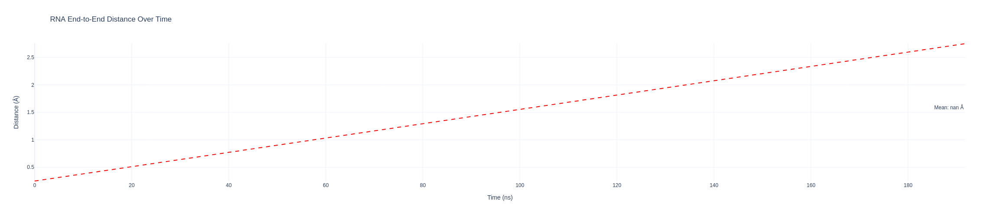

In [6]:
# Plot End-to-End Distance
fig_e2e = go.Figure()

fig_e2e.add_trace(go.Scatter(
    x=times_ns,
    y=distances,
    mode='lines',
    name='End-to-End Distance',
    line=dict(color='#1f77b4', width=2),
    hovertemplate='<b>Time:</b> %{x:.1f} ns<br><b>Distance:</b> %{y:.2f} Å<extra></extra>'
))

# Add mean line
mean_dist = np.nanmean(distances)
fig_e2e.add_hline(
    y=mean_dist, 
    line_dash="dash", 
    line_color="red",
    annotation_text=f"Mean: {mean_dist:.2f} Å"
)

fig_e2e.update_layout(
    title='RNA End-to-End Distance Over Time',
    xaxis_title='Time (ns)',
    yaxis_title='Distance (Å)',
    template='plotly_white',
    width=800,
    height=500
)

fig_e2e.show()

## 2. Radius of Gyration Analysis

In [7]:
class RadiusOfGyration(AnalysisBase):
    """Calculate radius of gyration for RNA"""
    
    def __init__(self, universe, selection="nucleic", **kwargs):
        super().__init__(universe.trajectory, **kwargs)
        self.selection = universe.select_atoms(selection)
        self.results.rg = []
        self.results.rg_components = []  # x, y, z components
    
    def _single_frame(self):
        # Calculate radius of gyration
        positions = self.selection.positions
        masses = self.selection.masses
        
        # Center of mass
        com = np.average(positions, axis=0, weights=masses)
        
        # Distances from COM
        distances = positions - com
        
        # Radius of gyration
        rg_squared = np.average(np.sum(distances**2, axis=1), weights=masses)
        rg = np.sqrt(rg_squared)
        
        # Components (principal axes)
        rg_x = np.sqrt(np.average(distances[:, 0]**2, weights=masses))
        rg_y = np.sqrt(np.average(distances[:, 1]**2, weights=masses))
        rg_z = np.sqrt(np.average(distances[:, 2]**2, weights=masses))
        
        self.results.rg.append(rg)
        self.results.rg_components.append([rg_x, rg_y, rg_z])

# Calculate radius of gyration
print("Calculating radius of gyration...")
rg_analysis = RadiusOfGyration(u, selection="nucleic")
rg_analysis.run()

rg_values = np.array(rg_analysis.results.rg)
rg_components = np.array(rg_analysis.results.rg_components)

print(f"Rg range: {np.min(rg_values):.2f} - {np.max(rg_values):.2f} Å")
print(f"Mean Rg: {np.mean(rg_values):.2f} ± {np.std(rg_values):.2f} Å")

Calculating radius of gyration...
Rg range: 8.03 - 16.12 Å
Mean Rg: 9.24 ± 1.34 Å


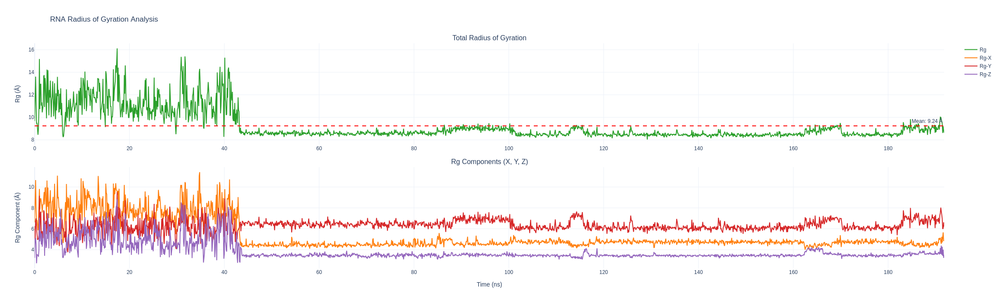

In [8]:
# Plot Radius of Gyration
fig_rg = make_subplots(
    rows=2, cols=1,
    subplot_titles=['Total Radius of Gyration', 'Rg Components (X, Y, Z)'],
    vertical_spacing=0.1
)

# Total Rg
fig_rg.add_trace(
    go.Scatter(
        x=times_ns,
        y=rg_values,
        mode='lines',
        name='Rg',
        line=dict(color='#2ca02c', width=2),
        hovertemplate='<b>Time:</b> %{x:.1f} ns<br><b>Rg:</b> %{y:.2f} Å<extra></extra>'
    ),
    row=1, col=1
)

# Components
colors = ['#ff7f0e', '#d62728', '#9467bd']
labels = ['Rg-X', 'Rg-Y', 'Rg-Z']

for i, (color, label) in enumerate(zip(colors, labels)):
    fig_rg.add_trace(
        go.Scatter(
            x=times_ns,
            y=rg_components[:, i],
            mode='lines',
            name=label,
            line=dict(color=color, width=2),
            hovertemplate=f'<b>Time:</b> %{{x:.1f}} ns<br><b>{label}:</b> %{{y:.2f}} Å<extra></extra>'
        ),
        row=2, col=1
    )

# Add mean lines
mean_rg = np.mean(rg_values)
fig_rg.add_hline(
    y=mean_rg, 
    line_dash="dash", 
    line_color="red",
    annotation_text=f"Mean: {mean_rg:.2f} Å",
    row=1, col=1
)

fig_rg.update_layout(
    title='RNA Radius of Gyration Analysis',
    template='plotly_white',
    width=800,
    height=700
)

fig_rg.update_xaxes(title_text="Time (ns)", row=2, col=1)
fig_rg.update_yaxes(title_text="Rg (Å)", row=1, col=1)
fig_rg.update_yaxes(title_text="Rg Component (Å)", row=2, col=1)

fig_rg.show()

## 3. DSSR Secondary Structure Analysis

Note: This requires DSSR (3DNA-DSSR) to be installed. If not available, we'll simulate the data structure.

In [15]:
import subprocess
import tempfile
import json

def run_dssr_analysis(universe, sample_frames=10):
    """Run DSSR analysis on selected frames"""
    
    # Sample frames to analyze (DSSR is slow)
    frame_indices = np.linspace(0, len(universe.trajectory)-1, sample_frames, dtype=int)
    
    dssr_results = []
    
    for i, frame_idx in enumerate(frame_indices):
        universe.trajectory[frame_idx]
        
        # Write current frame to temporary PDB
        with tempfile.NamedTemporaryFile(mode='w', suffix='.pdb', delete=False) as tmp_pdb:
            rna_atoms = universe.select_atoms("nucleic")
            rna_atoms.write(tmp_pdb.name)
            
            try:
                # Run DSSR (if available)
                input_i = f"-i={tmp_pdb.name}"
                result = subprocess.run(
                    ['/home/louis/Downloads/x3dna-dssr', input_i, '--json'],
                    capture_output=True, text=True, timeout=30
                )
                #print(result)
                
                if result.returncode == 0:
                    dssr_data = json.loads(result.stdout)
                    dssr_results.append({
                        'frame': frame_idx,
                        'time': times_ns[frame_idx],
                        'data': dssr_data
                    })
                else:
                    print(f"DSSR failed for frame {frame_idx}")
                    
            except (subprocess.TimeoutExpired, FileNotFoundError) as e:
                print(f"DSSR not available or timeout: {e}")
                # Generate mock data for demonstration
                dssr_results.append(create_mock_dssr_data(frame_idx, universe))
            
            # Clean up
            os.unlink(tmp_pdb.name)
    
    return dssr_results

def create_mock_dssr_data(frame_idx, universe):
    """Create mock DSSR data for demonstration"""
    residues = universe.select_atoms("nucleic").residues
    
    # Simulate secondary structure assignment
    np.random.seed(frame_idx)  # Consistent randomness per frame
    
    ss_types = ['helix', 'loop', 'bulge', 'junction', 'single_strand']
    weights = [0.3, 0.25, 0.15, 0.15, 0.15]  # Probabilities
    
    nucleotides = []
    for i, res in enumerate(residues):
        # Add some correlation to make realistic secondary structure
        if i > 0 and np.random.random() < 0.7:  # 70% chance to keep same type
            ss_type = nucleotides[-1]['ss_type']
        else:
            ss_type = np.random.choice(ss_types, p=weights)
        
        nucleotides.append({
            'index': i + 1,
            'resname': res.resname,
            'resnum': res.resid,
            'ss_type': ss_type
        })
    
    return {
        'frame': frame_idx,
        'time': times_ns[frame_idx],
        'data': {'nucleotides': nucleotides}
    }

# Run DSSR analysis
print("Running DSSR analysis (or creating mock data)...")
dssr_results = run_dssr_analysis(u, sample_frames=100)
print(f"Analyzed {len(dssr_results)} frames")

Running DSSR analysis (or creating mock data)...
Analyzed 100 frames


In [16]:
dssr_results

[{'frame': np.int64(0),
  'time': np.float64(0.0),
  'data': {'num_stacks': 1,
   'stacks': [{'index': 1,
     'num_nts': 7,
     'nts_short': 'GCAAGCC',
     'nts_long': 'A.G5,A.C6,A.A7,A.A8,A.G9,A.C10,A.C11'}],
   'nonStack': {'num_nts': 3,
    'nts_short': 'GGC',
    'nts_long': 'A.G2,A.G3,A.C4'},
   'num_atom2bases': 1,
   'atom2bases': [{'index': 1,
     'type': 'phosphate',
     'atom': "O5'@A.G2",
     'nt': 'A.G3',
     'vert_dist': 3.104}],
   'num_ssSegments': 1,
   'ssSegments': [{'index': 1,
     'num_nts': 10,
     'nts_short': 'GGCGCAAGCC',
     'nts_long': 'A.G2,A.G3,A.C4,A.G5,A.C6,A.A7,A.A8,A.G9,A.C10,A.C11'}],
   'num_splayUnits': 1,
   'splayUnits': [{'index': 1,
     'num_nts': 3,
     'nts_short': 'GCG',
     'nts_long': 'A.G3,A.C4,A.G5'}],
   'dbn': {'all_chains': {'num_nts': 10,
     'num_chars': 10,
     'bseq': 'GGCGCAAGCC',
     'sstr': '..........',
     'form': '...A.....-'},
    'chain_A': {'num_nts': 10,
     'num_chars': 10,
     'bseq': 'GGCGCAAGCC',
    

In [21]:
# Process DSSR results for plotting
def process_dssr_results(dssr_results):
    """Convert DSSR results to plotting format"""
    
    all_frames_data = []
    
    for result in dssr_results:
        frame = result['frame']
        time = result['time']
        nucleotides = result['data'].get('nts', [])
        
        for nuc in nucleotides:
            all_frames_data.append({
                'frame': frame,
                'time': time,
                'residue_number': nuc['index'],
                'residue_name': nuc['nt_id'],
                'ss_type': nuc['summary']
            })
    
    return pd.DataFrame(all_frames_data)

# Create DataFrame
dssr_df = process_dssr_results(dssr_results)
print(f"DSSR DataFrame shape: {dssr_df.shape}")
print("Secondary structure types found:")
print(dssr_df['ss_type'].value_counts())

DSSR DataFrame shape: (1000, 5)
Secondary structure types found:
ss_type
anti,~C3'-endo,BI,canonical,non-pair-contact,helix,stem                                   148
anti,~C3'-endo,BI,non-pair-contact,ss-non-loop                                             94
anti,~C3'-endo,BI,canonical,non-pair-contact,helix,stem-end,hairpin-loop                   82
anti,~C3'-endo,BI,canonical,non-pair-contact,helix-end,stem-end                            73
anti,~C3'-endo,canonical,non-pair-contact,helix-end,stem-end                               67
                                                                                         ... 
syn,~C2'-endo,BI,non-pair-contact,hairpin-loop,cap-acceptor                                 1
anti,~C3'-endo,BI,canonical,non-pair-contact,helix-end,stem-end,hairpin-loop,phosphate      1
anti,~C3'-endo,non-canonical,non-pair-contact,helix-end,ss-non-loop                         1
anti,BI,canonical,non-pair-contact,helix,stem-end                                

In [22]:
# Plot DSSR Secondary Structure Heatmap
# Create pivot table for heatmap
pivot_data = dssr_df.pivot_table(
    index='residue_number', 
    columns='time', 
    values='ss_type', 
    aggfunc='first'
)

# Map secondary structure types to numbers for heatmap
ss_type_map = {
    'helix': 4,
    'loop': 3,
    'bulge': 2,
    'junction': 1,
    'single_strand': 0
}

# Convert to numeric
numeric_data = pivot_data.map(ss_type_map)

# Create heatmap
fig_dssr = go.Figure(data=go.Heatmap(
    z=numeric_data.values,
    x=numeric_data.columns,
    y=numeric_data.index,
    colorscale=[
        [0, '#440154'],  # single_strand - purple
        [0.25, '#31688e'],  # junction - blue
        [0.5, '#35b779'],   # bulge - green
        [0.75, '#fde725'],  # loop - yellow
        [1, '#dc143c']      # helix - red
    ],
    hovertemplate='<b>Residue:</b> %{y}<br><b>Time:</b> %{x:.1f} ns<br><b>SS Type:</b> %{text}<extra></extra>',
    text=pivot_data.values,
    showscale=True,
    colorbar=dict(
        title="Secondary Structure",
        tickvals=[0, 1, 2, 3, 4],
        ticktext=['Single Strand', 'Junction', 'Bulge', 'Loop', 'Helix']
    )
))

fig_dssr.update_layout(
    title='RNA Secondary Structure Evolution (DSSR Analysis)',
    xaxis_title='Time (ns)',
    yaxis_title='Residue Number',
    template='plotly_white',
    width=900,
    height=600
)

fig_dssr.show()

TypeError: the first argument must be callable

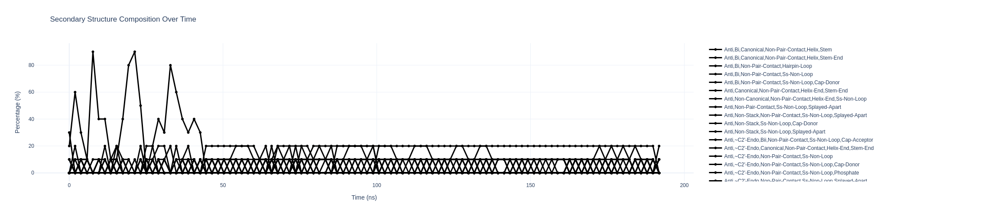

In [23]:
# Secondary structure composition over time
ss_composition = dssr_df.groupby(['time', 'ss_type']).size().unstack(fill_value=0)
ss_composition_pct = ss_composition.div(ss_composition.sum(axis=1), axis=0) * 100

fig_ss_comp = go.Figure()

colors = {
    'helix': '#dc143c',
    'loop': '#fde725', 
    'bulge': '#35b779',
    'junction': '#31688e',
    'single_strand': '#440154'
}

for ss_type in ss_composition_pct.columns:
    fig_ss_comp.add_trace(go.Scatter(
        x=ss_composition_pct.index,
        y=ss_composition_pct[ss_type],
        mode='lines+markers',
        name=ss_type.replace('_', ' ').title(),
        line=dict(color=colors.get(ss_type, '#000000'), width=3),
        hovertemplate=f'<b>Time:</b> %{{x:.1f}} ns<br><b>{ss_type.title()}:</b> %{{y:.1f}}%<extra></extra>'
    ))

fig_ss_comp.update_layout(
    title='Secondary Structure Composition Over Time',
    xaxis_title='Time (ns)',
    yaxis_title='Percentage (%)',
    template='plotly_white',
    width=800,
    height=500
)

fig_ss_comp.show()

## 4. PCA/UMAP/t-SNE Conformational Analysis

In [26]:
# Prepare coordinates for dimensionality reduction
def prepare_coordinates(universe, selection="nucleic"):
    """Extract coordinates for all frames"""
    
    atoms = universe.select_atoms(selection)
    print(f"Selected {len(atoms)} atoms for analysis")
    
    coordinates = []
    
    for ts in universe.trajectory:
        # Flatten coordinates to 1D array
        coords = atoms.positions.flatten()
        coordinates.append(coords)
    
    coordinates = np.array(coordinates)
    print(f"Coordinate matrix shape: {coordinates.shape}")
    
    return coordinates, atoms

# Get coordinates
print("Preparing coordinates for dimensionality reduction...")
coords, selected_atoms = prepare_coordinates(u, selection="nucleic")

# Align to remove translational and rotational motion
print("Aligning structures...")
reference_coords = coords[0].reshape(-1, 3)
aligned_coords = []

for i, frame_coords in enumerate(coords):
    frame_coords_3d = frame_coords.reshape(-1, 3)
    
    # Simple alignment (center at origin)
    ref_center = reference_coords.mean(axis=0)
    frame_center = frame_coords_3d.mean(axis=0)
    
    aligned_frame = frame_coords_3d - frame_center + ref_center
    aligned_coords.append(aligned_frame.flatten())

aligned_coords = np.array(aligned_coords)
print(f"Aligned coordinates shape: {aligned_coords.shape}")

Preparing coordinates for dimensionality reduction...
Selected 325 atoms for analysis
Coordinate matrix shape: (1919, 975)
Aligning structures...
Aligned coordinates shape: (1919, 975)


In [27]:
# PCA Analysis
print("Running PCA...")
pca = PCA(n_components=10)
pca_coords = pca.fit_transform(aligned_coords)

explained_variance = pca.explained_variance_ratio_
cumulative_variance = np.cumsum(explained_variance)

print(f"PC1 explains {explained_variance[0]*100:.1f}% of variance")
print(f"PC2 explains {explained_variance[1]*100:.1f}% of variance")
print(f"First 2 PCs explain {cumulative_variance[1]*100:.1f}% of variance")
print(f"First 3 PCs explain {cumulative_variance[2]*100:.1f}% of variance")

Running PCA...
PC1 explains 53.8% of variance
PC2 explains 8.1% of variance
First 2 PCs explain 61.8% of variance
First 3 PCs explain 68.0% of variance


In [28]:
# UMAP Analysis  
print("Running UMAP...")
umap_reducer = umap.UMAP(
    n_components=2, 
    n_neighbors=15, 
    min_dist=0.1, 
    random_state=42
)
umap_coords = umap_reducer.fit_transform(aligned_coords)

print(f"UMAP embedding shape: {umap_coords.shape}")

Running UMAP...


/media/louis/9cd13dc6-dcf0-4fea-90e9-ddb52c29bb29/conda_envs/LOUIS_THESE/lib/python3.10/site-packages/umap/umap_.py:1952: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



UMAP embedding shape: (1919, 2)


In [29]:
# t-SNE Analysis
print("Running t-SNE...")
# Use PCA preprocessing for t-SNE (recommended for high-dimensional data)
pca_50 = PCA(n_components=50)
pca_coords_50 = pca_50.fit_transform(aligned_coords)

tsne = TSNE(
    n_components=2, 
    perplexity=30, 
    random_state=42,
    init='pca'
)
tsne_coords = tsne.fit_transform(pca_coords_50)

print(f"t-SNE embedding shape: {tsne_coords.shape}")

Running t-SNE...
t-SNE embedding shape: (1919, 2)


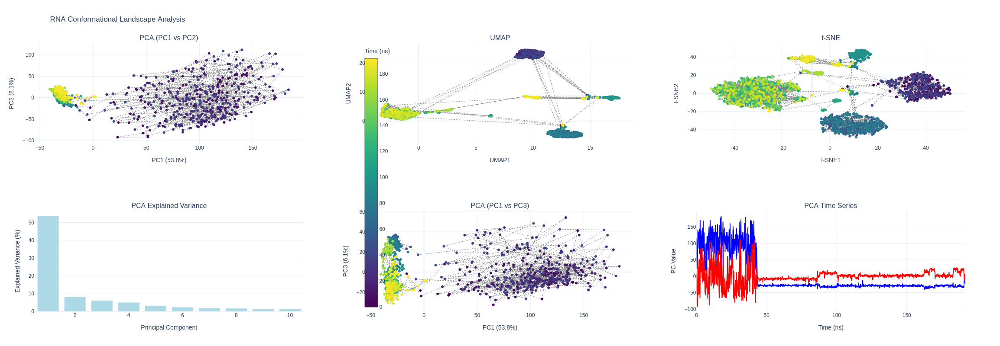

In [30]:
# Create comprehensive dimensionality reduction plot
fig_dimred = make_subplots(
    rows=2, cols=3,
    subplot_titles=[
        'PCA (PC1 vs PC2)', 'UMAP', 't-SNE',
        'PCA Explained Variance', 'PCA (PC1 vs PC3)', 'PCA Time Series'
    ],
    specs=[
        [{"type": "scatter"}, {"type": "scatter"}, {"type": "scatter"}],
        [{"type": "bar"}, {"type": "scatter"}, {"type": "scatter"}]
    ]
)

# Color by time
colors = times_ns
colorscale = 'Viridis'

# PCA PC1 vs PC2
fig_dimred.add_trace(
    go.Scatter(
        x=pca_coords[:, 0],
        y=pca_coords[:, 1],
        mode='markers+lines',
        marker=dict(
            color=colors,
            colorscale=colorscale,
            size=6,
            showscale=True,
            colorbar=dict(title="Time (ns)", x=0.35)
        ),
        line=dict(color='gray', width=1, dash='dot'),
        name='PCA Trajectory',
        hovertemplate='<b>PC1:</b> %{x:.2f}<br><b>PC2:</b> %{y:.2f}<br><b>Time:</b> %{marker.color:.1f} ns<extra></extra>'
    ),
    row=1, col=1
)

# UMAP
fig_dimred.add_trace(
    go.Scatter(
        x=umap_coords[:, 0],
        y=umap_coords[:, 1],
        mode='markers+lines',
        marker=dict(
            color=colors,
            colorscale=colorscale,
            size=6,
            showscale=False
        ),
        line=dict(color='gray', width=1, dash='dot'),
        name='UMAP Trajectory',
        hovertemplate='<b>UMAP1:</b> %{x:.2f}<br><b>UMAP2:</b> %{y:.2f}<br><b>Time:</b> %{marker.color:.1f} ns<extra></extra>'
    ),
    row=1, col=2
)

# t-SNE
fig_dimred.add_trace(
    go.Scatter(
        x=tsne_coords[:, 0],
        y=tsne_coords[:, 1],
        mode='markers+lines',
        marker=dict(
            color=colors,
            colorscale=colorscale,
            size=6,
            showscale=False
        ),
        line=dict(color='gray', width=1, dash='dot'),
        name='t-SNE Trajectory',
        hovertemplate='<b>t-SNE1:</b> %{x:.2f}<br><b>t-SNE2:</b> %{y:.2f}<br><b>Time:</b> %{marker.color:.1f} ns<extra></extra>'
    ),
    row=1, col=3
)

# PCA Explained Variance
fig_dimred.add_trace(
    go.Bar(
        x=list(range(1, 11)),
        y=explained_variance[:10] * 100,
        name='Explained Variance',
        marker_color='lightblue',
        hovertemplate='<b>PC%{x}:</b> %{y:.1f}% variance<extra></extra>'
    ),
    row=2, col=1
)

# PCA PC1 vs PC3
fig_dimred.add_trace(
    go.Scatter(
        x=pca_coords[:, 0],
        y=pca_coords[:, 2],
        mode='markers+lines',
        marker=dict(
            color=colors,
            colorscale=colorscale,
            size=6,
            showscale=False
        ),
        line=dict(color='gray', width=1, dash='dot'),
        name='PCA PC1 vs PC3',
        hovertemplate='<b>PC1:</b> %{x:.2f}<br><b>PC3:</b> %{y:.2f}<br><b>Time:</b> %{marker.color:.1f} ns<extra></extra>'
    ),
    row=2, col=2
)

# PCA Time Series (PC1 and PC2)
fig_dimred.add_trace(
    go.Scatter(
        x=times_ns,
        y=pca_coords[:, 0],
        mode='lines',
        name='PC1',
        line=dict(color='blue', width=2),
        hovertemplate='<b>Time:</b> %{x:.1f} ns<br><b>PC1:</b> %{y:.2f}<extra></extra>'
    ),
    row=2, col=3
)

fig_dimred.add_trace(
    go.Scatter(
        x=times_ns,
        y=pca_coords[:, 1],
        mode='lines',
        name='PC2',
        line=dict(color='red', width=2),
        yaxis='y2',
        hovertemplate='<b>Time:</b> %{x:.1f} ns<br><b>PC2:</b> %{y:.2f}<extra></extra>'
    ),
    row=2, col=3
)

# Update layout
fig_dimred.update_layout(
    title='RNA Conformational Landscape Analysis',
    template='plotly_white',
    width=1200,
    height=800,
    showlegend=False
)

# Update axes labels
fig_dimred.update_xaxes(title_text=f"PC1 ({explained_variance[0]*100:.1f}%)", row=1, col=1)
fig_dimred.update_yaxes(title_text=f"PC2 ({explained_variance[1]*100:.1f}%)", row=1, col=1)
fig_dimred.update_xaxes(title_text="UMAP1", row=1, col=2)
fig_dimred.update_yaxes(title_text="UMAP2", row=1, col=2)
fig_dimred.update_xaxes(title_text="t-SNE1", row=1, col=3)
fig_dimred.update_yaxes(title_text="t-SNE2", row=1, col=3)
fig_dimred.update_xaxes(title_text="Principal Component", row=2, col=1)
fig_dimred.update_yaxes(title_text="Explained Variance (%)", row=2, col=1)
fig_dimred.update_xaxes(title_text=f"PC1 ({explained_variance[0]*100:.1f}%)", row=2, col=2)
fig_dimred.update_yaxes(title_text=f"PC3 ({explained_variance[2]*100:.1f}%)", row=2, col=2)
fig_dimred.update_xaxes(title_text="Time (ns)", row=2, col=3)
fig_dimred.update_yaxes(title_text="PC Value", row=2, col=3)

fig_dimred.show()

## 5. Combined Analysis Dashboard

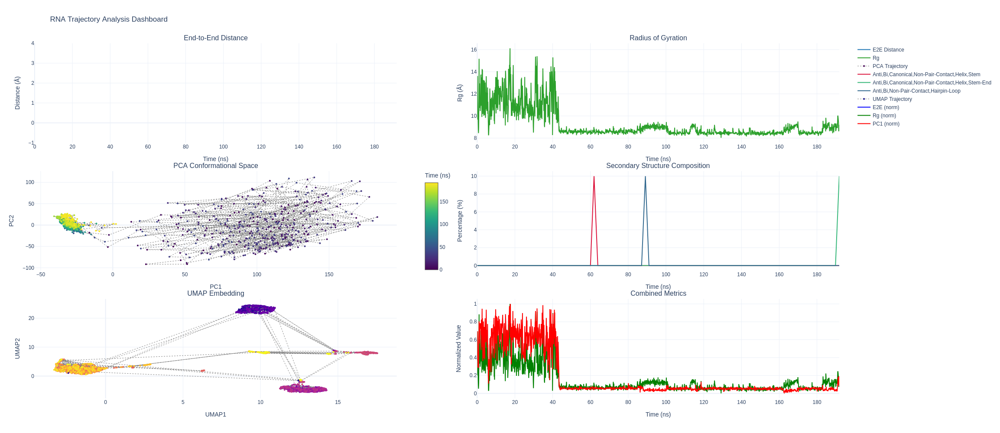

In [31]:
# Create a comprehensive dashboard combining all analyses
fig_dashboard = make_subplots(
    rows=3, cols=2,
    subplot_titles=[
        'End-to-End Distance', 'Radius of Gyration',
        'PCA Conformational Space', 'Secondary Structure Composition',
        'UMAP Embedding', 'Combined Metrics'
    ],
    specs=[
        [{"type": "scatter"}, {"type": "scatter"}],
        [{"type": "scatter"}, {"type": "scatter"}],
        [{"type": "scatter"}, {"type": "scatter"}]
    ],
    vertical_spacing=0.08
)

# End-to-End Distance
fig_dashboard.add_trace(
    go.Scatter(
        x=times_ns,
        y=distances,
        mode='lines',
        name='E2E Distance',
        line=dict(color='#1f77b4', width=2)
    ),
    row=1, col=1
)

# Radius of Gyration
fig_dashboard.add_trace(
    go.Scatter(
        x=times_ns,
        y=rg_values,
        mode='lines',
        name='Rg',
        line=dict(color='#2ca02c', width=2)
    ),
    row=1, col=2
)

# PCA
fig_dashboard.add_trace(
    go.Scatter(
        x=pca_coords[:, 0],
        y=pca_coords[:, 1],
        mode='markers+lines',
        marker=dict(
            color=times_ns,
            colorscale='Viridis',
            size=4,
            showscale=True,
            colorbar=dict(title="Time (ns)", x=0.48, len=0.3)
        ),
        line=dict(color='gray', width=1, dash='dot'),
        name='PCA Trajectory'
    ),
    row=2, col=1
)

# Secondary Structure Composition (if available)
if 'dssr_df' in locals() and not dssr_df.empty:
    ss_comp_simplified = dssr_df.groupby(['time', 'ss_type']).size().unstack(fill_value=0)
    ss_comp_pct_simplified = ss_comp_simplified.div(ss_comp_simplified.sum(axis=1), axis=0) * 100
    
    colors_ss = ['#dc143c', '#35b779', '#31688e', '#fde725', '#440154']
    
    for i, ss_type in enumerate(ss_comp_pct_simplified.columns[:3]):  # Show top 3
        fig_dashboard.add_trace(
            go.Scatter(
                x=ss_comp_pct_simplified.index,
                y=ss_comp_pct_simplified[ss_type],
                mode='lines',
                name=ss_type.title(),
                line=dict(color=colors_ss[i], width=2)
            ),
            row=2, col=2
        )

# UMAP
fig_dashboard.add_trace(
    go.Scatter(
        x=umap_coords[:, 0],
        y=umap_coords[:, 1],
        mode='markers+lines',
        marker=dict(
            color=times_ns,
            colorscale='Plasma',
            size=4,
            showscale=False
        ),
        line=dict(color='gray', width=1, dash='dot'),
        name='UMAP Trajectory'
    ),
    row=3, col=1
)

# Combined metrics (normalized)
# Normalize all metrics to 0-1 range for comparison
e2e_norm = (distances - np.min(distances)) / (np.max(distances) - np.min(distances))
rg_norm = (rg_values - np.min(rg_values)) / (np.max(rg_values) - np.min(rg_values))
pc1_norm = (pca_coords[:, 0] - np.min(pca_coords[:, 0])) / (np.max(pca_coords[:, 0]) - np.min(pca_coords[:, 0]))

fig_dashboard.add_trace(
    go.Scatter(
        x=times_ns,
        y=e2e_norm,
        mode='lines',
        name='E2E (norm)',
        line=dict(color='blue', width=2)
    ),
    row=3, col=2
)

fig_dashboard.add_trace(
    go.Scatter(
        x=times_ns,
        y=rg_norm,
        mode='lines',
        name='Rg (norm)',
        line=dict(color='green', width=2)
    ),
    row=3, col=2
)

fig_dashboard.add_trace(
    go.Scatter(
        x=times_ns,
        y=pc1_norm,
        mode='lines',
        name='PC1 (norm)',
        line=dict(color='red', width=2)
    ),
    row=3, col=2
)

# Update layout
fig_dashboard.update_layout(
    title='RNA Trajectory Analysis Dashboard',
    template='plotly_white',
    width=1000,
    height=1000,
    showlegend=True
)

# Update axis labels
fig_dashboard.update_xaxes(title_text="Time (ns)", row=1, col=1)
fig_dashboard.update_yaxes(title_text="Distance (Å)", row=1, col=1)
fig_dashboard.update_xaxes(title_text="Time (ns)", row=1, col=2)
fig_dashboard.update_yaxes(title_text="Rg (Å)", row=1, col=2)
fig_dashboard.update_xaxes(title_text="PC1", row=2, col=1)
fig_dashboard.update_yaxes(title_text="PC2", row=2, col=1)
fig_dashboard.update_xaxes(title_text="Time (ns)", row=2, col=2)
fig_dashboard.update_yaxes(title_text="Percentage (%)", row=2, col=2)
fig_dashboard.update_xaxes(title_text="UMAP1", row=3, col=1)
fig_dashboard.update_yaxes(title_text="UMAP2", row=3, col=1)
fig_dashboard.update_xaxes(title_text="Time (ns)", row=3, col=2)
fig_dashboard.update_yaxes(title_text="Normalized Value", row=3, col=2)

fig_dashboard.show()

## Summary and Export

This notebook has demonstrated several advanced RNA trajectory analysis techniques:

1. **End-to-End Distance**: Measures RNA extension/contraction
2. **Radius of Gyration**: Indicates compactness and folding
3. **DSSR Analysis**: Secondary structure evolution over time
4. **Dimensionality Reduction**: PCA, UMAP, and t-SNE for conformational analysis

These plots can be integrated into the web application to provide comprehensive RNA dynamics analysis.

In [ ]:
# Export plot data for integration into web app
import json

# Prepare data for export
export_data = {
    'end_to_end_distance': {
        'time': times_ns.tolist(),
        'distance': distances.tolist(),
        'mean': float(np.nanmean(distances)),
        'std': float(np.nanstd(distances))
    },
    'radius_of_gyration': {
        'time': times_ns.tolist(),
        'rg': rg_values.tolist(),
        'rg_components': rg_components.tolist(),
        'mean': float(np.mean(rg_values)),
        'std': float(np.std(rg_values))
    },
    'pca_analysis': {
        'coordinates': pca_coords[:, :3].tolist(),  # First 3 PCs
        'explained_variance': explained_variance[:10].tolist(),
        'time': times_ns.tolist()
    },
    'umap_analysis': {
        'coordinates': umap_coords.tolist(),
        'time': times_ns.tolist()
    },
    'tsne_analysis': {
        'coordinates': tsne_coords.tolist(),
        'time': times_ns.tolist()
    }
}

# Add DSSR data if available
if 'dssr_df' in locals() and not dssr_df.empty:
    export_data['dssr_analysis'] = {
        'secondary_structure_data': dssr_df.to_dict('records'),
        'composition_over_time': ss_composition_pct.to_dict()
    }

# Save to file
with open('advanced_rna_analysis_results.json', 'w') as f:
    json.dump(export_data, f, indent=2)

print("Analysis results exported to 'advanced_rna_analysis_results.json'")
print(f"File size: {os.path.getsize('advanced_rna_analysis_results.json') / 1024:.1f} KB")